In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def color_based_segmentation(image):
    """Generates a mask for alive trees based on color segmentation."""
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_green = np.array([25, 40, 40])
    upper_green = np.array([110, 255, 255])
    mask = cv2.inRange(hsv_image, lower_green, upper_green)
    return mask

def generate_masks_and_visualize(image_folder, output_folder):
    """Generates masks for each image in the specified folder,
       saves the masks to the output folder, and visualizes them."""
    
    # Get all images from the folder
    image_files = [f for f in os.listdir(image_folder) if f.endswith(('jpg', 'png', 'jpeg'))]
    
    # Ensure the output folder exists
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through each image file
    for image_file in image_files:
        # Read the image
        image_path = os.path.join(image_folder, image_file)
        image = cv2.imread(image_path)

        # Generate the mask
        mask = color_based_segmentation(image)

        # Save the mask to the output folder
        mask_file_path = os.path.join(output_folder, f"mask_{image_file}")
        cv2.imwrite(mask_file_path, mask)

        # Visualize the original image and mask
        plt.figure(figsize=(10, 5))
        
        # Show original image
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')
        
        # Show mask
        plt.subplot(1, 2, 2)
        plt.imshow(mask, cmap='gray')
        plt.title('Generated Mask')
        plt.axis('off')
        
        plt.show()


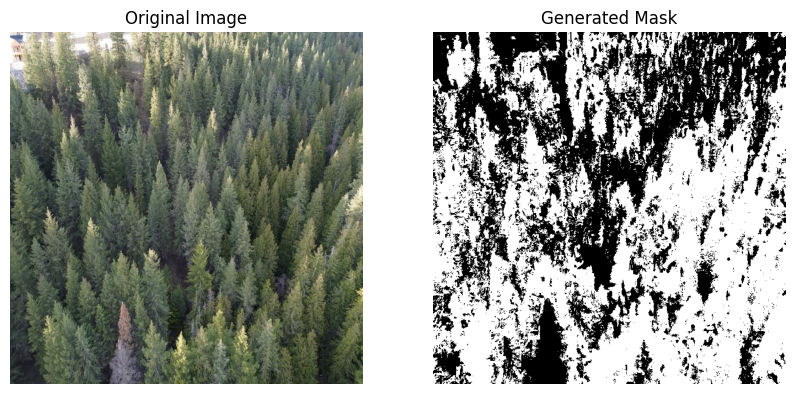

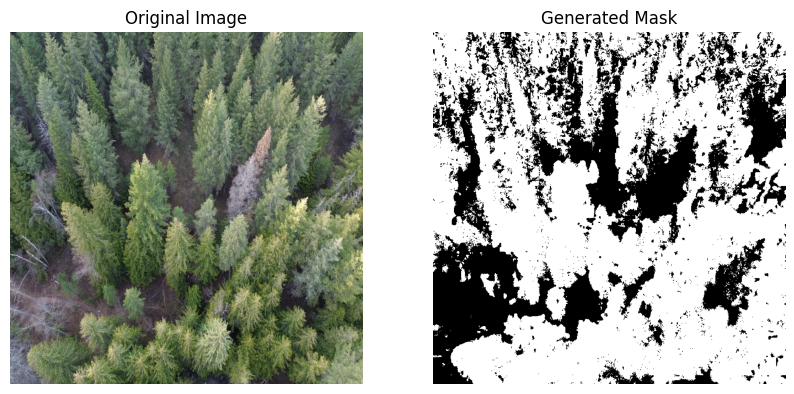

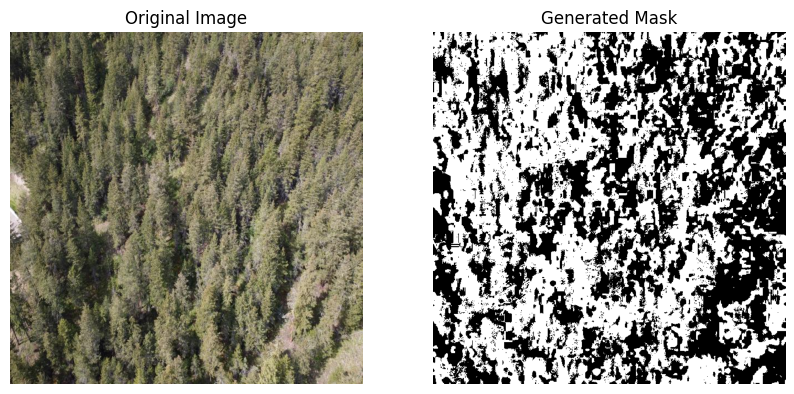

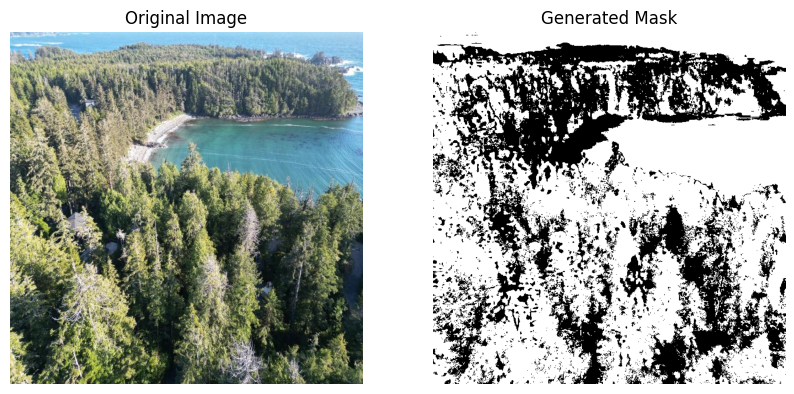

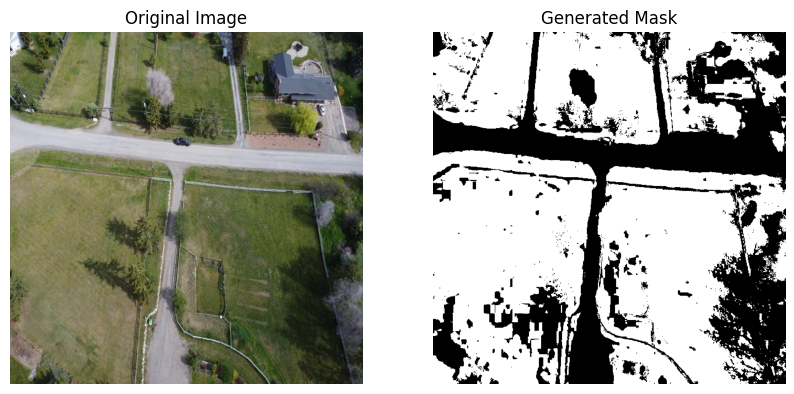

...

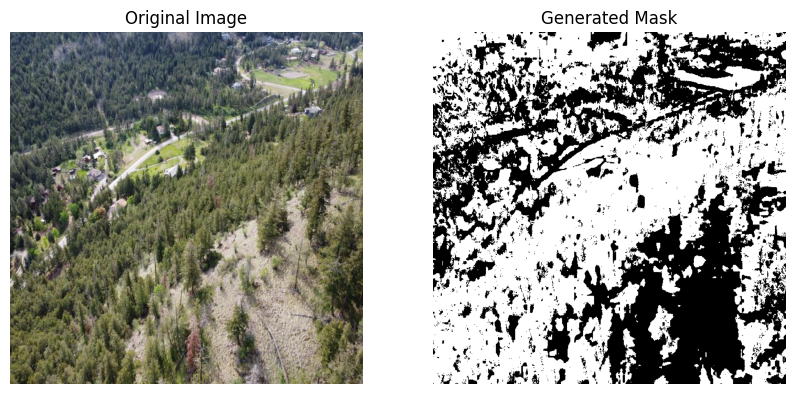

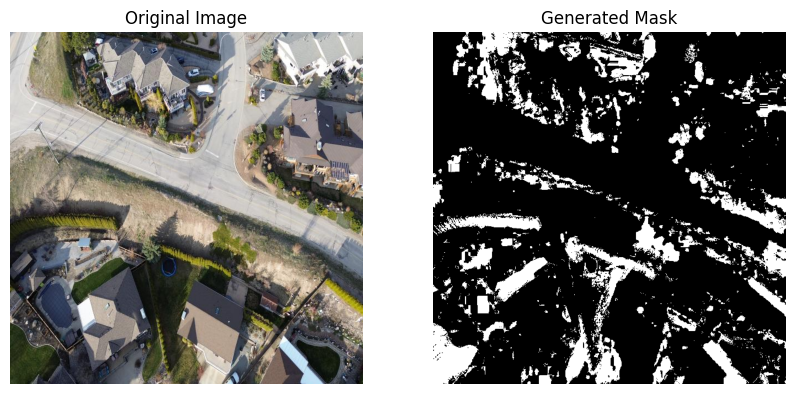

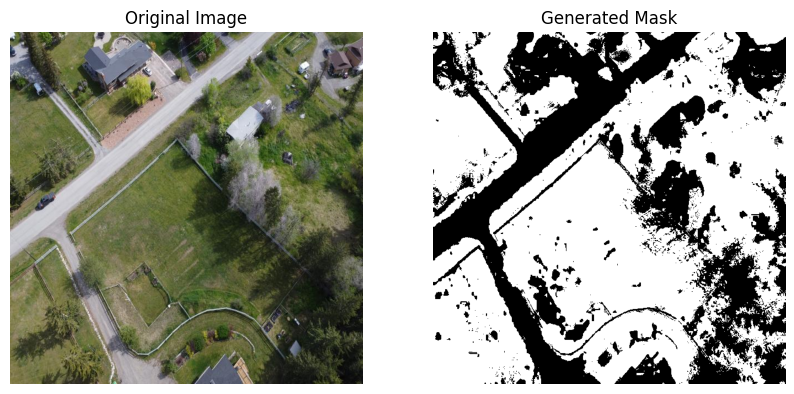

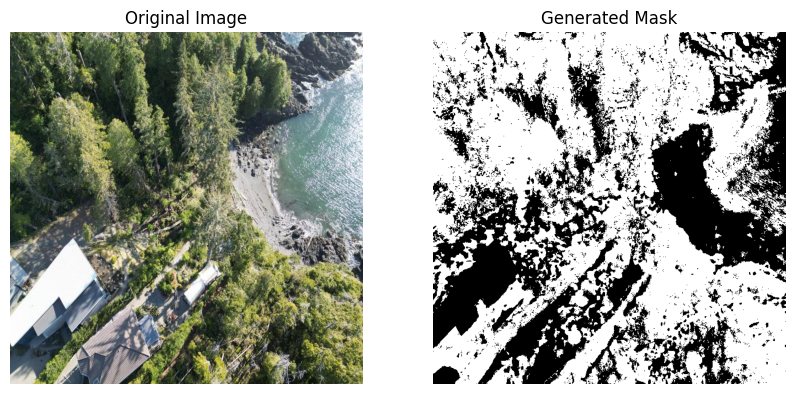

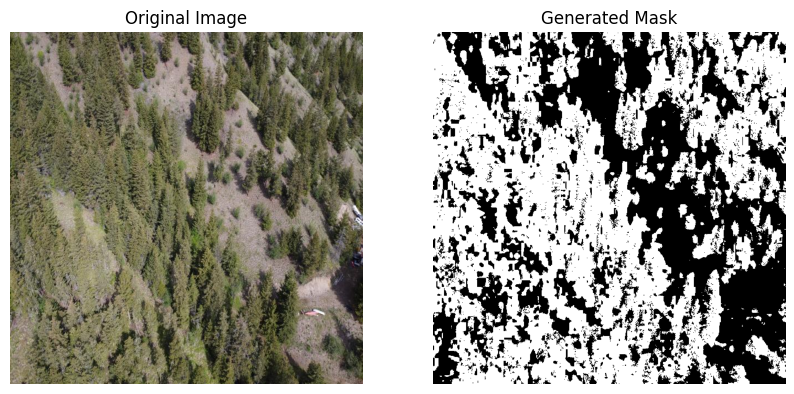

In [2]:
input_folder = 'wildfire-week5/test/original' 
output_folder_path = 'wildfire-week5/test/hsv'  
generate_masks_and_visualize(input_folder, output_folder_path)